# Making images of eFEDS cluster candidates in XMM, SDSS, and eFEDS

In this notebook we make side-by-side-by-side images of X-ray selected eFEDS cluster candidates that fall on an XMM observation; with the left hand side images are from XMM, the middle images from SDSS, and the right hand shide images from eFEDS. 

These images were used to eyeball the eFEDS-XMM sample and produce the final eFEDS-XCS sample. The eFEDS images used were generated previously, and are equivelant in pixel scale and location to the XMM pointing that they are being compared with.

## Import Statements

In [1]:
import pandas as pd
from astropy.units import Quantity
from astropy.cosmology import LambdaCDM
from matplotlib import pyplot as plt
from matplotlib.patches import Circle
import numpy as np
import scipy.odr as odr
from subprocess import Popen, PIPE
from regions import PixelRegion, EllipsePixelRegion, CirclePixelRegion, PixCoord
from copy import deepcopy
from shutil import copyfile
import requests
import os

from xga.samples.extended import ClusterSample
from xga.xspec import single_temp_apec
from xga.relations.fit import scaling_relation_lira
from xga.sourcetools.match import simple_xmm_match
from xga.models import straight_line, convert_to_odr_compatible
from xga import CENSUS
from xga.exceptions import ModelNotAssociatedError, FailedProductError
from xga.sas import evselect_image, eexpmap, emosaic
from xga.products import Image
from xga.imagetools.misc import pix_deg_scale
from xga.imagetools.misc import data_limits

## Check that the directory structure is setup

We wish to be sure that the directories in which we will store all the images actually exist, and if they don't then we will make them:

In [2]:
if not os.path.exists("images/sdss"):
    os.makedirs("images/sdss")
    
if not os.path.exists("images/xmm_efeds"):
    os.makedirs("images/xmm_efeds")
    
if not os.path.exists("images/xmm_efeds_sdss"):
    os.makedirs("images/xmm_efeds_sdss")

## Setting up an SDSS image fetch function and position conversion function

The cutout server URL allows us to request cutout SDSS RGB (i-r-g filters) at a specific location and with a specific width and height. We also create a quantity to store the pixel scale of the images generated by the SDSS cutout server. These two variables can then be used (in combination with an input side length and central coordinates) to create a function that fetches an appropriate SDSS image:

In [3]:
sdss_url = "https://skyserver.sdss.org/dr16/SkyserverWS/ImgCutout/getjpeg?ra={r}&dec={d}&width={p}&height={p}"
sdss_pix_size = Quantity(0.396127, 'arcsec/pix')

# Not as thorough as I would normally be checking input units etc, but as this is just for this 
#  analysis that is fine
def fetch_sdss(xga_source, central_coord: Quantity, side_length: Quantity):
    # Using the input source to convert the side length to arcseconds, regardless of its input unit
    as_side_length = xga_source.convert_radius(side_length, 'arcsec')
    #  Then using the known SDSS pixel side to convert from arcseconds to pixels
    pix_side_length = (as_side_length / sdss_pix_size).to('pix').round(0).astype(int)
    # Setting up the name to store the image under, with the central RA and Dec rather than a source 
    #  name, just to be nice and general
    sdss_im_name = "images/sdss/sdss_{r}_{d}_{s}x{s}{u}.jpg".format(r=central_coord[0].value,
                                                                    d=central_coord[1].value,
                                                                    s=side_length.value,
                                                                    u=side_length.unit.to_string())
    # Formatting the general SDSS cutout server URL for this specific case
    cur_url = sdss_url.format(r=central_coord[0].value, d=central_coord[1].value, p=pix_side_length.value)
    # If we haven't already downloaded this image then the request will be triggered
    if not os.path.exists(sdss_im_name):
        # Grabs the image from SDSS
        request = requests.get(cur_url, allow_redirects=True)
        # Writes the image to the filename we specified earlier
        with open(sdss_im_name, 'wb') as imago:
            imago.write(request.content)
    
    # Returns the image name, regardless of whether we downloaded it this time, or had already downloaded it
    return sdss_im_name


def conv_pos(conv_coord, xga_source, central_coord: Quantity, side_length: Quantity):
    # Using the input source to convert the side length to arcseconds, regardless of its input unit
    as_side_length = xga_source.convert_radius(side_length, 'arcsec')
    #  Then using the known SDSS pixel side to convert from arcseconds to pixels
    pix_side_length = (as_side_length / sdss_pix_size).to('pix').round(0).astype(int)
    
    ra_diff_pix = ((conv_coord[0] - central_coord[0])/sdss_pix_size).to('pix')
    ra_pix = (pix_side_length/2) - ra_diff_pix
    
    dec_diff_pix = ((conv_coord[1] - central_coord[1])/sdss_pix_size).to('pix')
    dec_pix = (pix_side_length/2) - dec_diff_pix
    
    return ra_pix, dec_pix

## Setting up paths to FITS images

We define paths to the locations of the 0.5-2.0keV, merged (EPN+EMOS1+EMOS2), image produced by XCS for a given XMM observation - these images are not publically available. We also setup a path to the 0.2-2.3keV eFEDS images generated to be equivalent to XMM observations that intersect with the eFEDS field - these are available on request, but are not difficult to produce by yourself.

These energy bands were chosen because they are the bands in which XCS and eFEDS do their source detection.

In [4]:
xmm_im_path = "/home/dt237/apollo_mnt/xmm_obs/data/{0}/images/{0}-0.50-2.00keVmerged_img.fits"
efeds_im_path = "xmm_obsid_equivalents/eFEDS_0.2-2.3keV_{}.fits"

## Defining a simple concordance cosmology

As stated in the paper, we use this cosmology for all of our analysis. Its main relevance here is in the conversion of a radius in kpc to a radius in degrees.

In [5]:
cosmo = LambdaCDM(70, 0.3, 0.7)

## Reading in the eFEDS X-ray selected cluster candidate catalogue

Here we read in the eFEDS X-ray cluster candidate sample (Liu et al. 2021), which contains 542 X-ray selected cluster candidates - this file is [available](https://erosita.mpe.mpg.de/edr/eROSITAObservations/Catalogues/liuA/eFEDS_clusters_V3.fits.gz), but we have converted it to a csv for convenience.

We also create a new 'name' column using the unique ID_SRC identifier assigned to each eFEDS source. We choose to use this rather than the 'ID' column because the names in the 'ID' column are not necessarily consistent between the X-ray selected cluster and optical counterpart samples.

In [6]:
sample = pd.read_csv("sample_files/efeds_xray_cluster_candidates.csv")
sample['name'] = sample['ID_SRC'].apply(lambda x: "eFEDS-"+str(x))
sample.head(10)

,ID,ID_SRC,RA,DEC,EXT_LIKE,DET_LIKE,z,z_type,T_300kpc,T_300kpc_L,...,L_500kpc_U,Lbol_500kpc,Lbol_500kpc_L,Lbol_500kpc_U,F_500kpc,F_500kpc_L,F_500kpc_U,SNR_MAX,R_SNR_MAX_ARCMIN,name
0,eFEDS J082626.6-003429,28993,126.610799,-0.574787,8.486203,5.029723,0.161110,0,-1.000000,-1.000000,...,3.924900e+42,-1.000000e+00,-1.000000e+00,1.782000e+43,-1.000000e+00,-1.000000e+00,6.040400e-14,1.32,0.8011,eFEDS-28993
1,eFEDS J082751.8-002853,11248,126.965471,-0.481638,12.791595,27.865910,0.257160,0,-1.000000,-1.000000,...,1.061100e+43,-1.000000e+00,-1.000000e+00,1.796300e+43,-1.000000e+00,-1.000000e+00,4.903300e-14,3.07,0.7393,eFEDS-11248
2,eFEDS J082808.8-001003,4800,127.036645,-0.167715,28.492811,62.512480,0.076155,0,0.885294,0.786329,...,3.424700e+42,4.402300e+42,3.640200e+42,5.339000e+42,1.976100e-13,1.624400e-13,2.382600e-13,8.78,2.6312,eFEDS-4800
3,eFEDS J082820.6-000721,4169,127.085556,-0.122752,42.376125,81.378350,0.844900,0,-1.000000,-1.000000,...,2.762200e+44,6.207600e+44,5.089800e+44,8.013600e+44,7.796600e-14,6.555100e-14,8.961400e-14,7.30,1.4667,eFEDS-4169
4,eFEDS J082840.6-000500,7991,127.169202,-0.083552,18.438711,37.515427,0.319705,0,-1.000000,-1.000000,...,2.065400e+43,3.993600e+43,3.175500e+43,4.931700e+43,5.510200e-14,4.443600e-14,6.466500e-14,5.61,1.3388,eFEDS-7991
5,eFEDS J082900.0+010756,14973,127.249974,1.132314,19.179321,14.365816,0.354000,0,-1.000000,-1.000000,...,2.451900e+43,6.481100e+43,4.081500e+43,9.963200e+43,4.924400e-14,3.510200e-14,6.559700e-14,4.29,3.1570,eFEDS-14973
6,eFEDS J082952.7+002140,7528,127.469684,0.361084,7.729656,38.626640,0.420000,0,-1.000000,-1.000000,...,1.842500e+43,3.816700e+43,2.719200e+43,5.480800e+43,2.461900e-14,1.860900e-14,3.194200e-14,4.61,0.6790,eFEDS-7528
7,eFEDS J082955.5+004132,3810,127.480999,0.692199,24.177258,80.255554,0.939855,0,-1.000000,-1.000000,...,2.318200e+44,6.930800e+44,5.228000e+44,1.003800e+45,5.564200e-14,4.690000e-14,6.435100e-14,6.96,1.2089,eFEDS-3810
8,eFEDS J083040.7+023220,9837,127.669739,2.538833,11.481833,23.703844,0.111320,0,-1.000000,-1.000000,...,1.044400e+42,1.166300e+42,7.767600e+41,1.637600e+42,2.241900e-14,1.482700e-14,3.137000e-14,3.29,0.7179,eFEDS-9837
9,eFEDS J083110.6+015616,5601,127.794012,1.937839,11.771409,34.137924,0.419510,0,-1.000000,-1.000000,...,4.363200e+43,9.198500e+43,7.453000e+43,1.215700e+44,6.304600e-14,5.262900e-14,7.444600e-14,6.85,1.7166,eFEDS-5601


## Defining our cluster sample

Here we define an XGA cluster sample using the eFEDS X-ray selected cluster candidates. This tells us which eFEDS candidates have XMM data, and allows us to define the eFEDS-XMM sample. 

In this case we have set `clean_obs_threshold=0.7`, which means that 70% of a particular region must lie on an observation for that observation to be accepted, we have also set `clean_obs_reg='r500'` which specifies that the test region in this case should be the value for R$_{500}$, though as we do not know the R$_{500}$s of these clusters we are using a fixed 300kpc aperture instead. 

We tell the sample object to use the input eFEDS RA and Dec values (by setting `use_peak=False`, meaning an X-ray peak **won't** be calculated and used as the central position), to use the concordance cosmology we defined earlier (the default cosmology uses the Planck 2015 results), and to place the background annulus between 2\*analysis radius and 3\*analysis radius.

In [7]:
# We use the RA and Dec coordinates from the eFEDS X-ray selected cluster candidate catalogue 
ra = sample['RA'].values
dec = sample['DEC'].values
z = sample['z'].values
n = sample['name'].values

srcs = ClusterSample(ra, dec, z, n, r500=Quantity([300]*len(sample), 'kpc'), use_peak=False, 
                     back_inn_rad_factor=2, back_out_rad_factor=3, clean_obs=True, clean_obs_reg='r500', 
                     clean_obs_threshold=0.7, load_fits=False, cosmology=cosmo)

Declaring BaseSource Sample:   0%|          | 0/542 [00:00<?, ?it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-28993 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-11248 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-4800 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-4169 does not appear to have any XMM data, and will not be i

/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-4731 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:   8%|▊         | 46/542 [00:00<00:02, 223.25it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-5321 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-6303 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-2456 does not appear to have any XMM data, and will 

/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-7213 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-3270 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-7217 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-4839 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any 

/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-2859 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:  22%|██▏       | 119/542 [00:09<01:33,  4.53it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-4861 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-6903 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-2475 does not appear to have any XMM data, and will 

Declaring BaseSource Sample:  29%|██▉       | 158/542 [00:15<01:44,  3.66it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-4736 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:  30%|██▉       | 160/542 [00:16<01:45,  3.62it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-2437 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-1073 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: 

Declaring BaseSource Sample:  40%|███▉      | 215/542 [00:38<03:25,  1.59it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-32576 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:  40%|████      | 218/542 [00:39<03:10,  1.70it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-24300 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-5261 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77

Declaring BaseSource Sample:  48%|████▊     | 260/542 [00:56<04:18,  1.09it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-3199 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:  49%|████▊     | 263/542 [00:58<03:07,  1.49it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-3800 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-431 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:  49%|████▉     | 267/542 [01:01<0

Declaring BaseSource Sample:  60%|█████▉    | 323/542 [01:46<02:27,  1.48it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-5772 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-638 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:  60%|██████    | 326/542 [01:46<01:52,  1.91it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-13180 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: 

Declaring BaseSource Sample:  67%|██████▋   | 365/542 [01:48<00:49,  3.60it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-1917 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-2154 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:  68%|██████▊   | 368/542 [01:49<00:41,  4.18it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-6244 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
Declaring BaseSource Sample:  68%|██████▊   | 370/542 [01:49<

Declaring BaseSource Sample:  76%|███████▌  | 411/542 [01:57<00:46,  2.80it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-10334 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-1915 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-489 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-18194 does not appear to have any XMM data, and will

Declaring BaseSource Sample:  85%|████████▍ | 459/542 [02:03<00:17,  4.78it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-12965 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-6875 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-671 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-10285 does not appear to have any XMM data, and will

Declaring BaseSource Sample:  95%|█████████▌| 515/542 [02:05<00:02, 12.56it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-5618 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-6577 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-900 does not appear to have any XMM data, and will not be included in the sample.
  warn("Source {n} does not appear to have any XMM data, and will not be included in the "
/home/dt237/code/PycharmProjects/XGA/xga/samples/base.py:77: UserWarning: Source eFEDS-1641 does not appear to have any XMM data, and will n

Setting up Galaxy Clusters:  78%|███████▊  | 98/125 [00:06<00:03,  7.99it/s]/home/dt237/code/PycharmProjects/XGA/xga/sources/general.py:99: UserWarning: eFEDS-6605 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters:  82%|████████▏ | 102/125 [00:09<00:06,  3.36it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/extended.py:119: UserWarning: After applying the criteria for the minimum amount of cluster required on an observation, eFEDS-5591 cannot be declared as all potential observations were removed
  warn("After applying the criteria for the minimum amount of cluster required on an "
Setting up Galaxy Clusters:  82%|████████▏ | 103/125 [00:10<00:12,  1.75it/s]/home/dt237/code/PycharmProjects/XGA/xga/sources/general.py:84: UserWarning: There are 1 alternative matches for obs

Setting up Galaxy Clusters: 170it [00:40,  1.42it/s]/home/dt237/code/PycharmProjects/XGA/xga/sources/general.py:99: UserWarning: eFEDS-8602 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters: 172it [00:42,  1.26it/s]/home/dt237/code/PycharmProjects/XGA/xga/sources/general.py:99: UserWarning: eFEDS-1023 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters: 174it [00:45,  1.25s/it]/home/dt237/code/PycharmProjects/XGA/xga/samples/extended.py:119: UserWarning: After applying the criteria for the minimum amount of cluster required on an observation, eFEDS-8679 cannot be decl

Setting up Galaxy Clusters: 260it [01:36,  1.71s/it]/home/dt237/code/PycharmProjects/XGA/xga/sources/general.py:99: UserWarning: eFEDS-4232 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters: 262it [01:39,  1.67s/it]/home/dt237/code/PycharmProjects/XGA/xga/samples/extended.py:119: UserWarning: After applying the criteria for the minimum amount of cluster required on an observation, eFEDS-2048 cannot be declared as all potential observations were removed
  warn("After applying the criteria for the minimum amount of cluster required on an "
Setting up Galaxy Clusters: 263it [01:40,  1.53s/it]/home/dt237/code/PycharmProjects/XGA/xga/sources/general.py:84: UserWarning: There are 1 alternative matches for observation 0725300159, associated with source eFEDS-6840
  warnings.warn("Th

Setting up Galaxy Clusters: 308it [03:25,  2.96s/it]/home/dt237/code/PycharmProjects/XGA/xga/samples/extended.py:119: UserWarning: After applying the criteria for the minimum amount of cluster required on an observation, eFEDS-2234 cannot be declared as all potential observations were removed
  warn("After applying the criteria for the minimum amount of cluster required on an "
Setting up Galaxy Clusters: 310it [03:26,  2.19s/it]/home/dt237/code/PycharmProjects/XGA/xga/sources/general.py:99: UserWarning: eFEDS-7084 has not been detected in all region files, so generating and fitting products with the 'region' reg_type will not use all available data
  warnings.warn("{n} has not been detected in all region files, so generating and fitting products"
Setting up Galaxy Clusters: 311it [03:27,  2.04s/it]/home/dt237/code/PycharmProjects/XGA/xga/sources/general.py:99: UserWarning: eFEDS-885 has not been detected in all region files, so generating and fitting products with the 'region' reg_typ

Setting up Galaxy Clusters: 430it [03:55,  2.01it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/extended.py:119: UserWarning: After applying the criteria for the minimum amount of cluster required on an observation, eFEDS-7637 cannot be declared as all potential observations were removed
  warn("After applying the criteria for the minimum amount of cluster required on an "
Setting up Galaxy Clusters: 434it [03:56,  2.33it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/extended.py:119: UserWarning: After applying the criteria for the minimum amount of cluster required on an observation, eFEDS-4806 cannot be declared as all potential observations were removed
  warn("After applying the criteria for the minimum amount of cluster required on an "
Setting up Galaxy Clusters: 435it [03:56,  1.92it/s]/home/dt237/code/PycharmProjects/XGA/xga/samples/extended.py:119: UserWarning: After applying the criteria for the minimum amount of cluster required on an observation, eFEDS-8858 cannot

## Creating an eFEDS-XMM sample file

This outputs a simple file with identifying information on the candidates in the eFEDS-XMM sample:

In [8]:
# Use the XGA ClusterSample to tell use which candidates got through the cleaning processes
#  and have suitable XMM data - make a subset of the full sample using those names
efeds_xmm = sample[sample['name'].isin(srcs.names)]
# Select only a small subset of the columns to save to the file - all the information remains in the 
#  catalogue file, this new sample file is only for convenience.
efeds_xmm = efeds_xmm[['ID_SRC', 'name', 'RA', 'DEC', 'z']]
# Save the file
efeds_xmm.to_csv("sample_files/efeds-xmm_sample.csv", index=False)
efeds_xmm.head(10)

,ID_SRC,name,RA,DEC,z
97,5702,eFEDS-5702,130.295289,0.866770,0.415210
101,6605,eFEDS-6605,130.352971,0.776778,0.407500
104,1644,eFEDS-1644,130.395834,1.030562,0.506660
109,3008,eFEDS-3008,130.450684,0.819822,0.078375
114,3334,eFEDS-3334,130.507566,0.994977,0.086645
139,144,eFEDS-144,131.369500,3.460887,0.334325
163,7831,eFEDS-7831,132.272302,2.243272,0.395420
171,8602,eFEDS-8602,132.592720,0.268673,0.195760
172,1023,eFEDS-1023,132.616040,0.250854,0.196655
173,6125,eFEDS-6125,132.627176,0.558439,0.191720


## Generating comparison images

Using our XMM and equivalent eFEDS images, as well as the function we have written to download images from SDSS' cutout server, we can create a variety of comparison images. Firstly we generate them for all the eFEDS-XMM sample, with different sidelengths.

### Side-by-side XMM-eROSITA images

Here we generate side by side comparison images between XMM and eROSITA, both for a zoom side length of 2000kpc, and the whole XMM field of view/eROSITA equivalents. For each source in the eFEDS-XMM sample, we choose to use the combined XMM (EPN+EMOS1+EMOS2) image for the observation with the highest signal to noise (if there are multiple observations of the same candidate). We use the view method built into XGA image objects:

/home/dt237/code/PycharmProjects/XGA/xga/products/phot.py:155: UserWarning: You are loading an image with elements that are < 0, they will be set to 0.
  warnings.warn("You are loading an {} with elements that are < 0, "


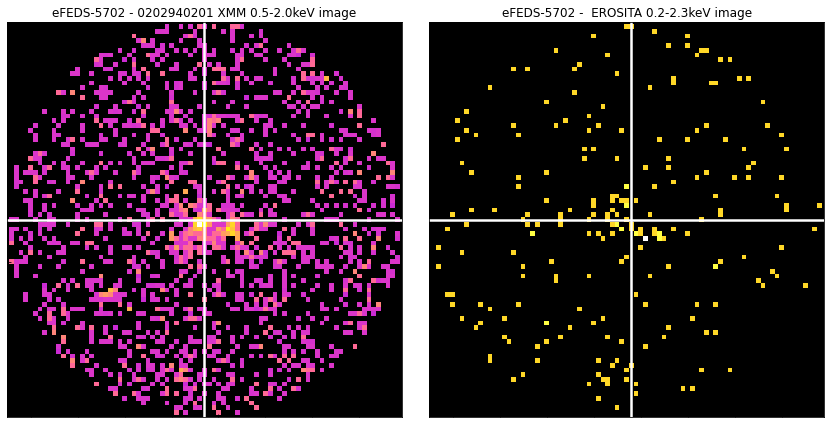

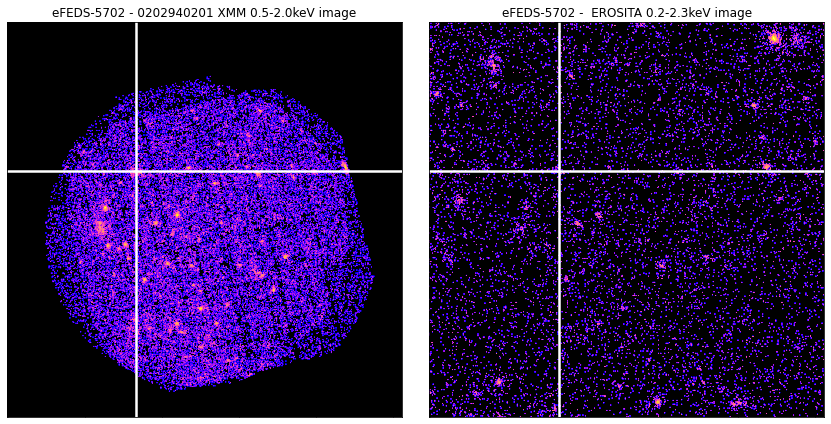

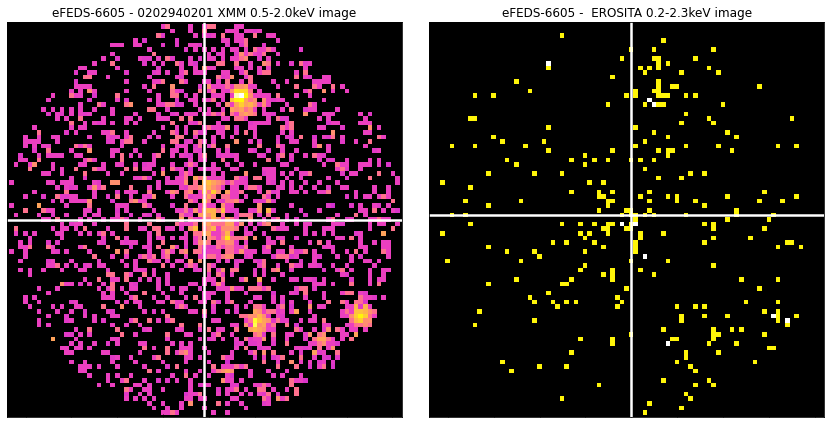

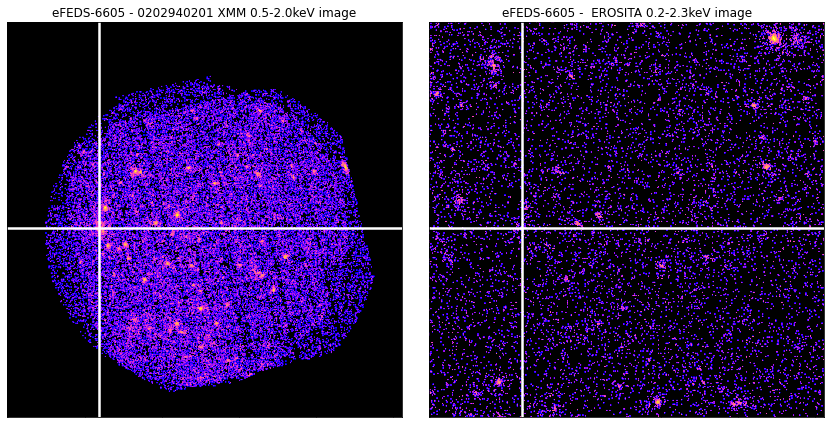

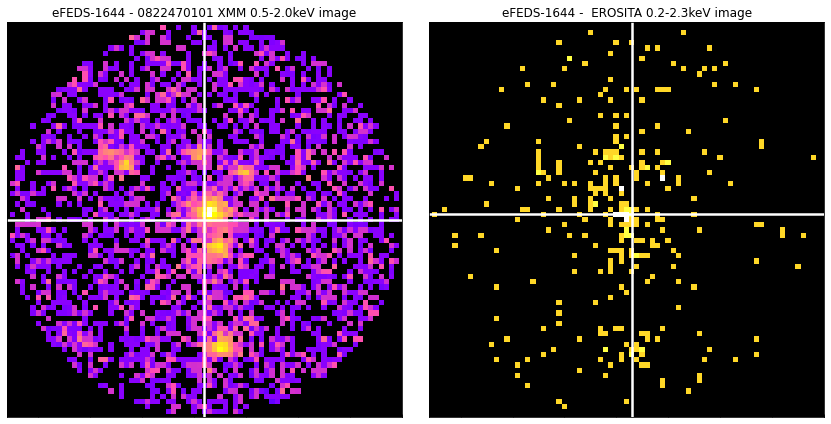

...

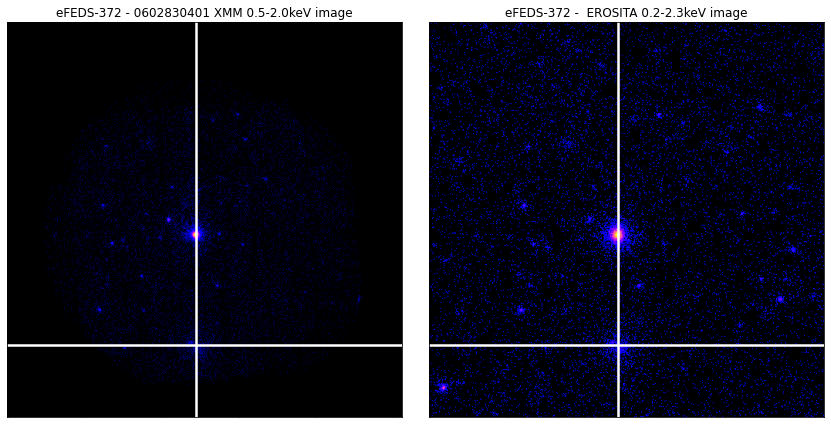

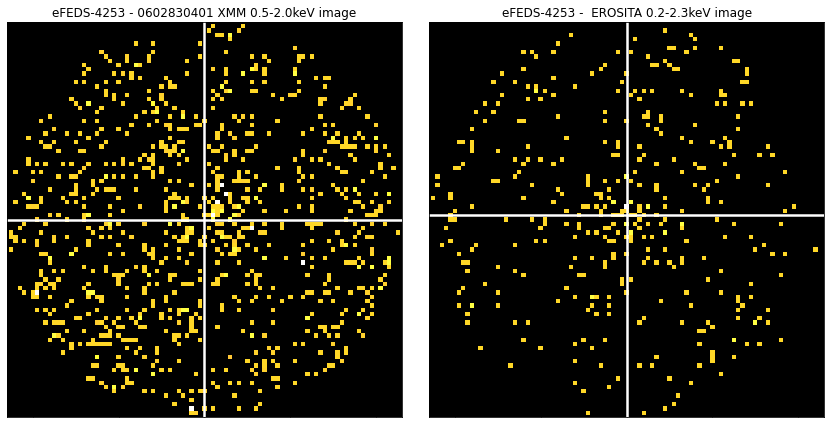

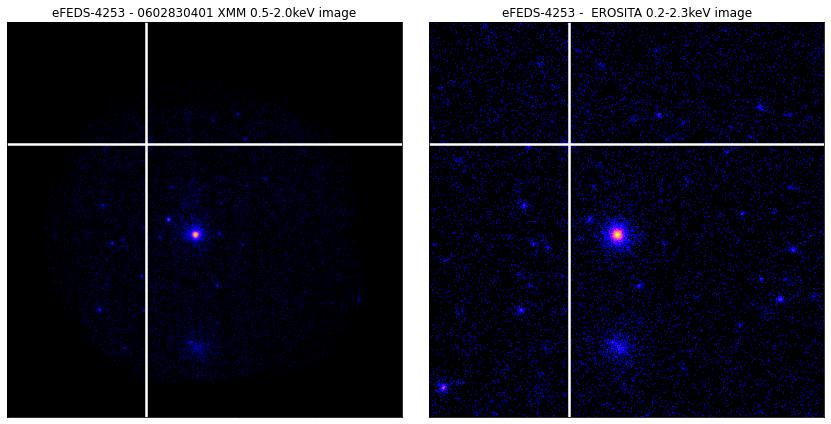

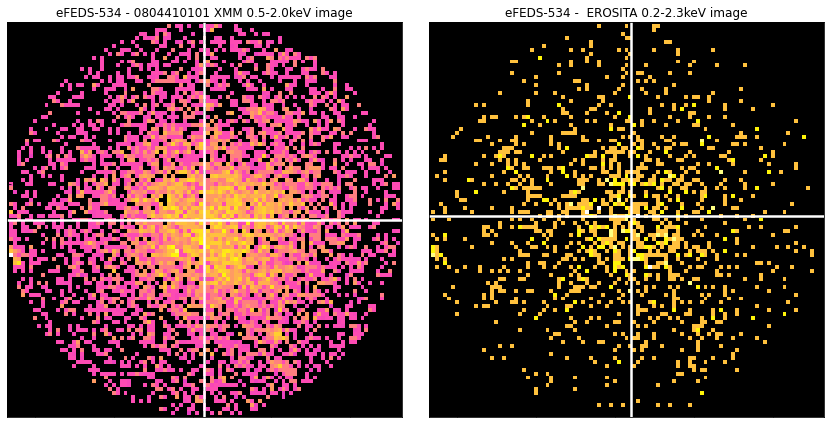

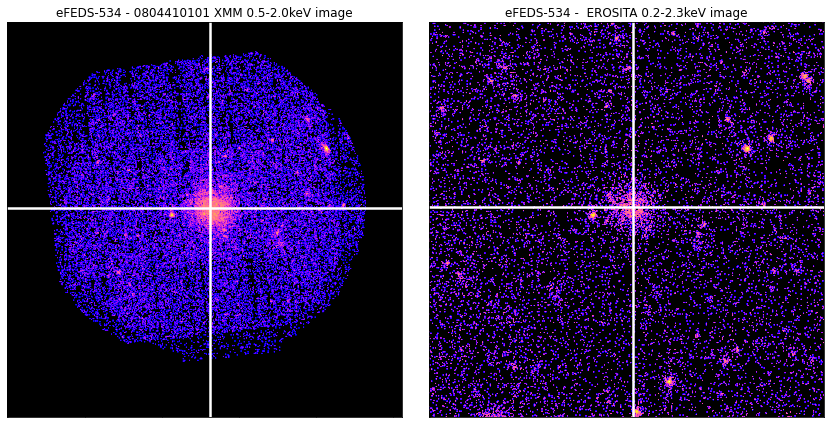

/home/dt237/code/PycharmProjects/XGA/xga/products/phot.py:1615: RuntimeWarning: invalid value encountered in double_scalars
  av_back = (self.data * back_mask).sum() / back_area
/home/dt237/code/PycharmProjects/XGA/xga/products/phot.py:1624: RuntimeWarning: invalid value encountered in less
  source_map[source_map < 0] = 0


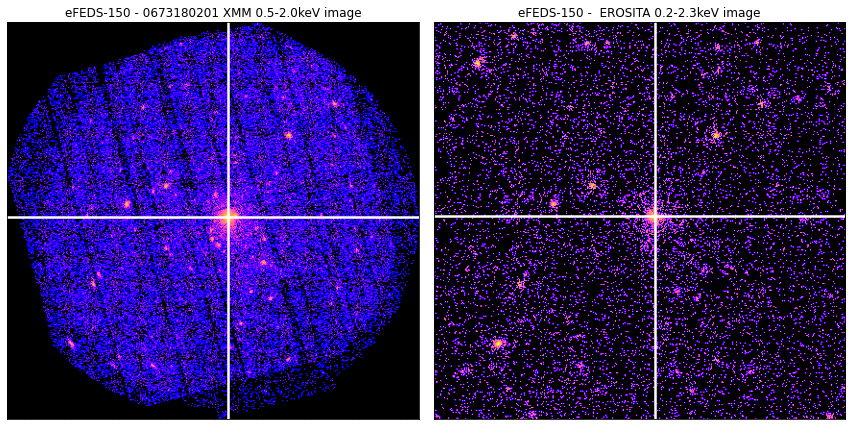

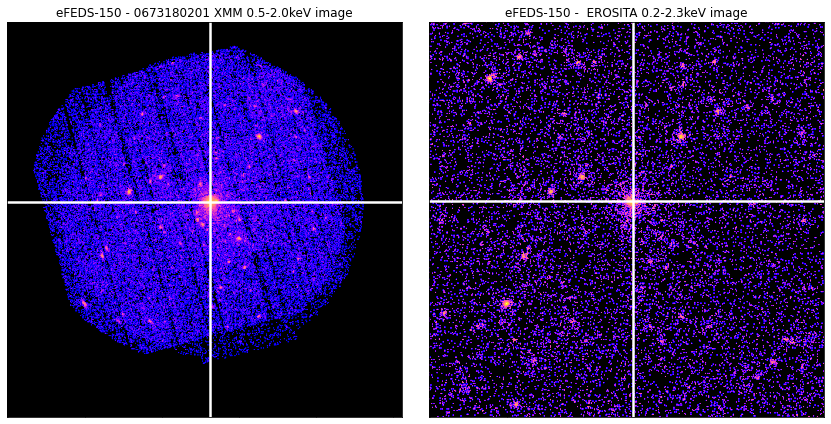

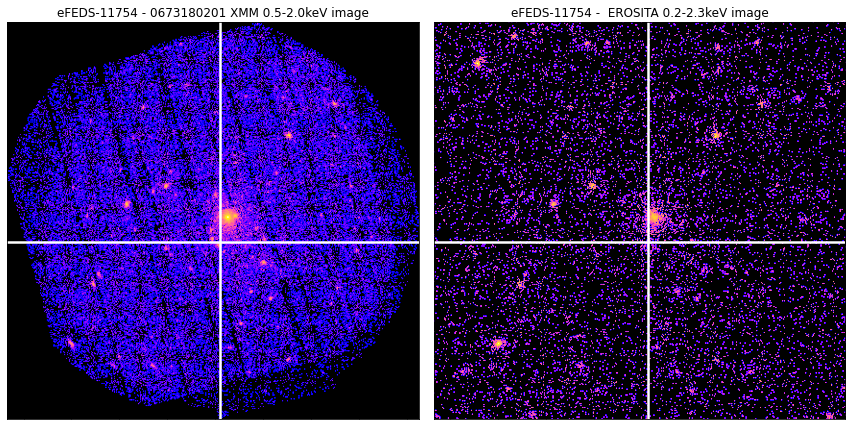

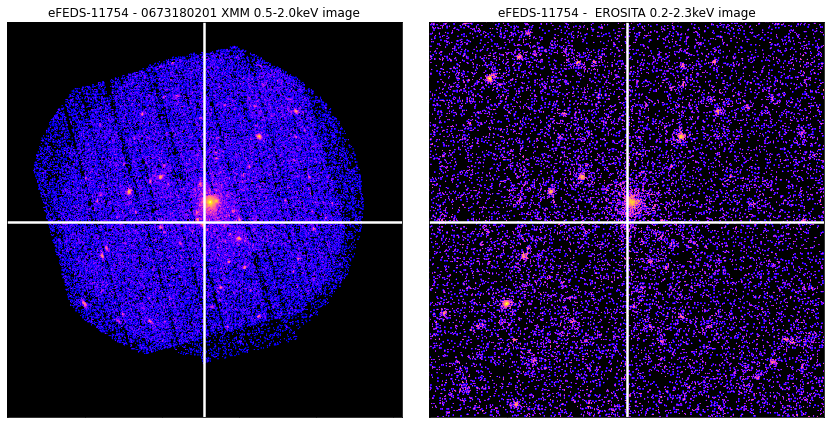

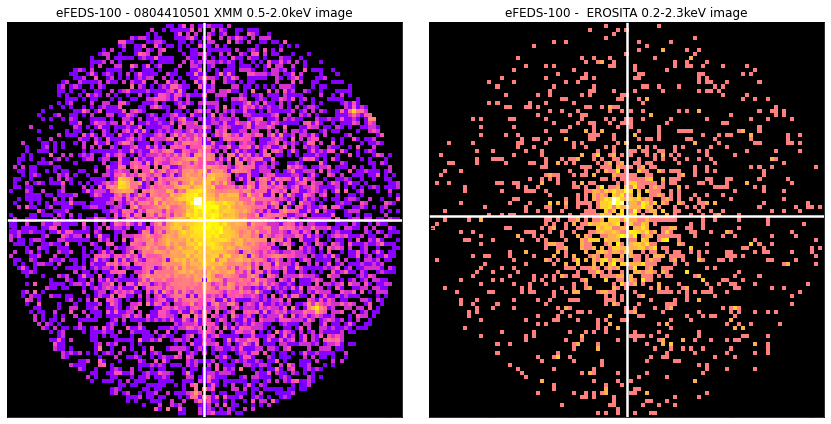

...

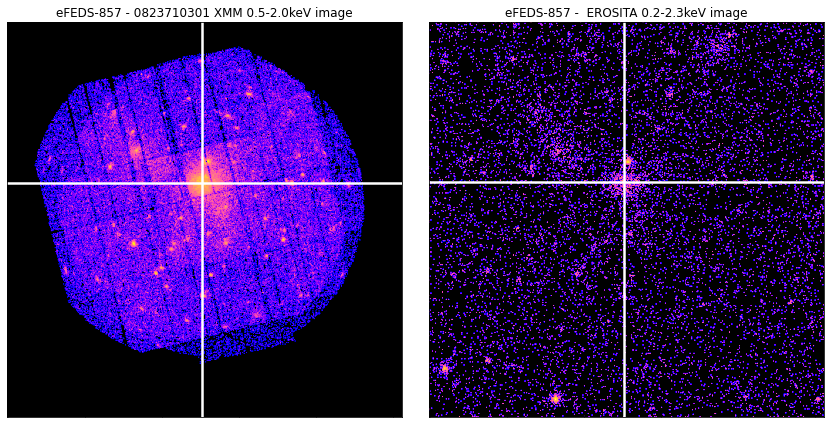

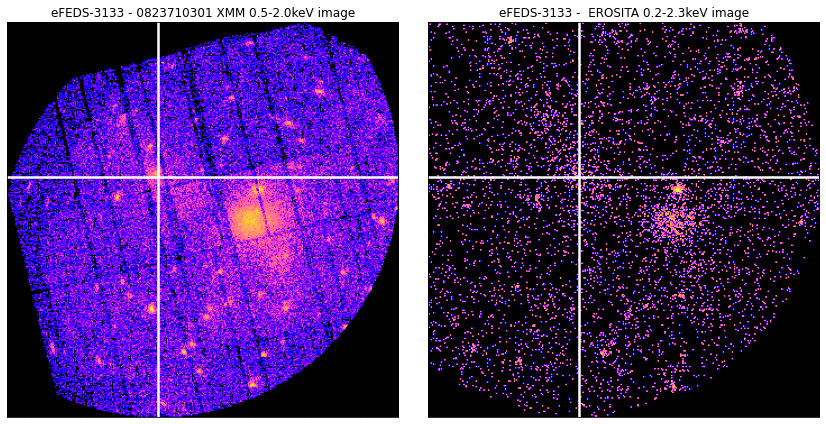

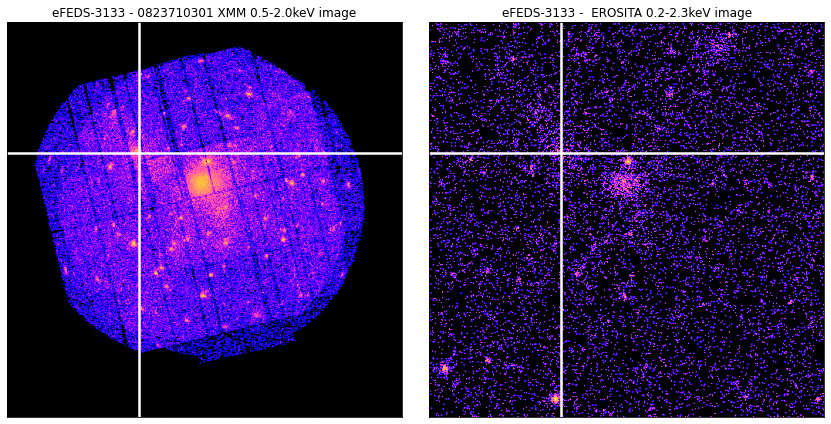

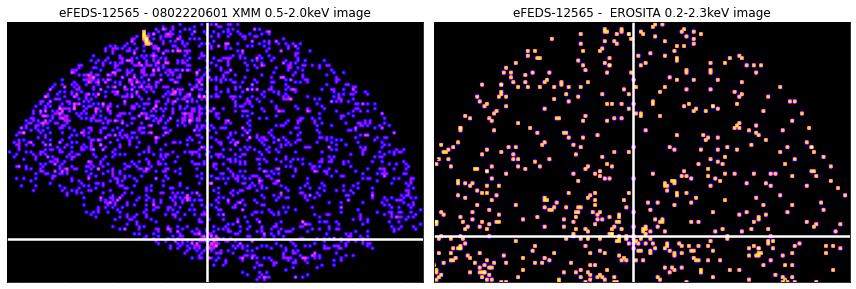

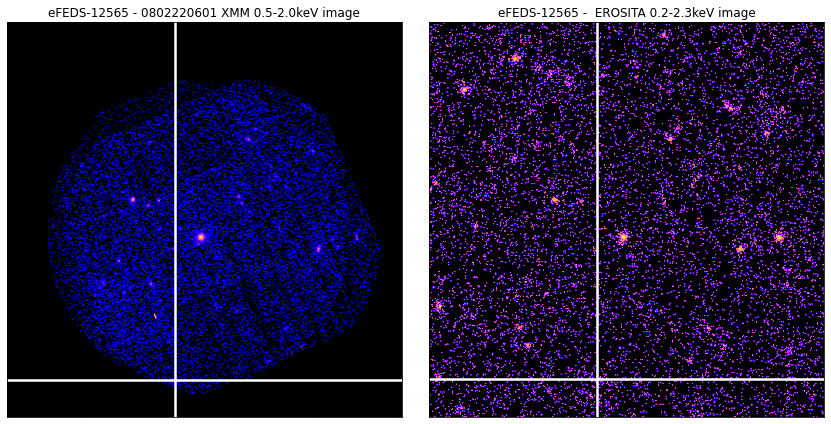

In [9]:
# Setting the aperture radius, this means we'll make images with a side length of twice this radius
ap_rad = Quantity(1000, 'kpc')

# Cycling through every cluster candidate in the eFEDS-XMM sample
for src in srcs:    
    # The SNR observation-instrument rankings for a 300kpc aperture
    ranks = src.snr_ranking(Quantity(300, 'kpc'))
    # Selecting the best observation-instrument
    best = ranks[0][-1]
    # Getting a 1000kpc radius mask without interloper sources removed
    cust_mask = src.get_custom_mask(ap_rad, obs_id=best[0], remove_interlopers=False)
    
    # Reading in and setting up the XCS produced combined image
    xmm_im = Image(xmm_im_path.format(best[0]), best[0], 'XMM', '', '', '', Quantity(0.5, 'keV'), 
                   Quantity(2.0, 'keV'))
    xmm_im.src_name = src.name
    
    # Reading in the equivalent eROSITA image for that particular ObsID, setting up XGA image object
    efedim_path = efeds_im_path.format(best[0])
    eros_im = Image(efedim_path, '', 'eROSITA', '', '', '', Quantity(0.2, 'keV'), 
                    Quantity(2.3, 'keV'))
    eros_im.src_name = src.name
    
    # Setting up a figure with two columns, one for XMM and one for eROSITA
    fig, ax_arr = plt.subplots(ncols=2, figsize=(12, 6))

    plt.sca(ax_arr[0])
    # Getting the axis normally displayed by the XGA image.view method and adding to our figure here
    xmm_im_ax = xmm_im.get_view(ax_arr[0], src.ra_dec, cust_mask, view_regions=False, zoom_in=True, 
                                ch_thickness=2.5)
    
    # Doing the same for the eROSITA image
    plt.sca(ax_arr[1])
    lim_lims = data_limits(xmm_im.data*cust_mask)
    eros_im_ax = eros_im.get_view(ax_arr[1], src.ra_dec, cust_mask, view_regions=False, zoom_in=True, 
                                  ch_thickness=2.5, manual_zoom_xlims=lim_lims[0], 
                                  manual_zoom_ylims=lim_lims[1])
    
    # Trying to minimise gaps between images
    plt.subplots_adjust(wspace=0, hspace=0)

    plt.tight_layout()
    efeds_xmm_path = "images/xmm_efeds/xmm_efeds_{n}_{s}x{s}{u}.png".format(n=src.name, s=ap_rad.value*2, 
                                                                            u=ap_rad.unit.to_string())
    # Saving the image
    plt.savefig(efeds_xmm_path)
    # We also show the image
    plt.show()
    plt.close('all')
    
    # HERE WE MAKE THE IMAGE OF THE FULL FIELD OF VIEW
    # Setting up a figure with two columns, one for XMM and one for eROSITA
    fig, ax_arr = plt.subplots(ncols=2, figsize=(12, 6))

    plt.sca(ax_arr[0])
    # Getting the axis normally displayed by the XGA image.view method and adding to our figure here
    xmm_im_ax = xmm_im.get_view(ax_arr[0], src.ra_dec, view_regions=False, zoom_in=False, ch_thickness=2.5)
    
    # Doing the same for the eROSITA image
    plt.sca(ax_arr[1])
    lim_lims = data_limits(xmm_im.data*cust_mask)
    eros_im_ax = eros_im.get_view(ax_arr[1], src.ra_dec, view_regions=False, zoom_in=False, ch_thickness=2.5)
    
    # Trying to minimise gaps between images
    plt.subplots_adjust(wspace=0, hspace=0)

    plt.tight_layout()
    efeds_xmm_path = "images/xmm_efeds/xmm_efeds_{n}_fov.png".format(n=src.name, s=ap_rad.value*2, 
                                                                            u=ap_rad.unit.to_string())
    # Saving the image
    plt.savefig(efeds_xmm_path)
    # We also show the image
    plt.show()
    plt.close('all')
    print('\n\n')

### Side-by-side-by-side zoom images XMM-eROSITA-SDSS

This function creates the image specified by the input source, X-ray aperture radius, and SDSS aperture radius:

In [10]:
def side_by_side_by_side(src, ap_rad, sdss_ap_rad):
    
    # This function will grab the appropriate SDSS image if we haven't already got it, then return the
    #  path to the file
    cur_sdss_path = fetch_sdss(src, src.ra_dec, sdss_ap_rad*2)
    sdss_pix_pos = conv_pos(src.ra_dec, src, src.ra_dec, sdss_ap_rad*2)
          
    # Same process as before, finding the best observation
    ranks = src.snr_ranking(Quantity(300, 'kpc'))
    best = ranks[0][-1]
    # Setting up the aperture mask
    cust_mask = src.get_custom_mask(ap_rad, obs_id=best[0], remove_interlopers=False)
    
    # Setting up the XMM image in an XGA image object
    xmm_im = Image(xmm_im_path.format(best[0]), best[0], 'XMM', '', '', '', Quantity(0.5, 'keV'), 
                   Quantity(2.0, 'keV'))
    xmm_im.src_name = src.name
    
    # Setting up the eROSITA image in an XGA image object
    efedim_path = efeds_im_path.format(best[0])
    eros_im = Image(efedim_path, '', 'eROSITA', '', '', '', Quantity(0.2, 'keV'), 
                    Quantity(2.3, 'keV'))
    eros_im.src_name = src.name
    # Converting the aperture radius to degrees
    deg_ap = src.convert_radius(ap_rad, 'deg')
    # Converting the SDSS aperture radius to degrees
    sdss_deg_ap = src.convert_radius(sdss_ap_rad, 'deg')
    # And converting that to XMM pixels
    xmm_pix = (deg_ap/pix_deg_scale(src.ra_dec, xmm_im.radec_wcs)).value.round().astype(int)
    
    # The final output path for the comparison image
    out_path = "images/xmm_efeds_sdss/xmm_efeds_{s}x{s}{u}_sdss_"\
               "{ss}x{ss}{su}_{n}.png".format(n=src.name, s=ap_rad.value*2, u=ap_rad.unit.to_string(), 
                                              ss=sdss_ap_rad.value*2, su=sdss_ap_rad.unit.to_string())
    # This makes sure that the manual limits set using the radius in pixels doesn't wrap around the 
    #  array and start to grab from negative indices
    if xmm_pix < 256:
        # Read out the central pixel coordinates of the source for XMM/eROSITA
        pix_cen = xmm_im.coord_conv(src.ra_dec, 'pix')
        # Make a new variable thats just a value rather than a quantity
        xmm_cen = pix_cen.value
        manual_zoom_xlims = [xmm_cen[0]-xmm_pix, xmm_cen[0]+xmm_pix]
        manual_zoom_ylims = [xmm_cen[1]-xmm_pix, xmm_cen[1]+xmm_pix]
        
        # Setup the three column figure
        fig, ax_arr = plt.subplots(ncols=3, figsize=(18, 6))
        
        # Add the XMM image
        plt.sca(ax_arr[0])
        xmm_im_ax = xmm_im.get_view(ax_arr[0], pix_cen, cust_mask, view_regions=False, zoom_in=True, 
                                    ch_thickness=1.5, manual_zoom_xlims=manual_zoom_xlims, 
                                    manual_zoom_ylims=manual_zoom_ylims)
        ax_arr[0].tick_params(axis='both', direction='in', which='both', top=False, right=False, length=0)
        
        # Define an arcminute to make the line after shorter
        am = Quantity(1, 'arcmin')
        # Find the number of pixels for an arcminute
        xmm_arcmin = (am/pix_deg_scale(src.ra_dec, xmm_im.radec_wcs)).to('pix').value.round().astype(int)
        
        # Add the aperture radius as an arrow, then label it with the input size of ap_rad
        plt.arrow(xmm_cen[0], xmm_cen[1]-xmm_pix+1, xmm_pix+1, 0, fc='white', width=0.8, 
                  length_includes_head=True)
        plt.annotate("{v} {u}".format(v=int(ap_rad.value), u=ap_rad.unit.to_string()), 
                     xy=(xmm_cen[0]+(xmm_pix/4), xmm_cen[1]-xmm_pix+2), color='white', fontsize=20, 
                     xycoords='data', weight=700)
        
        # For reference, we do the same arrow-adding business but with an arcminute
        start_x = xmm_cen[0] + ((xmm_pix+1)-xmm_arcmin)
        plt.arrow(start_x, xmm_cen[1]-xmm_pix+6, xmm_arcmin, 0, fc='white', width=0.8, 
                  length_includes_head=True)
        plt.annotate(r"1 $^\prime$", xy=(start_x+(xmm_arcmin/4), xmm_cen[1]-xmm_pix+7), color='white', 
                     fontsize=20, xycoords='data', weight=700)
        

        # Add the eROSITA image
        plt.sca(ax_arr[1])
        eros_im_ax = eros_im.get_view(ax_arr[1], pix_cen, cust_mask, view_regions=False, zoom_in=True, 
                                      ch_thickness=1.5, manual_zoom_xlims=manual_zoom_xlims,
                                      manual_zoom_ylims=manual_zoom_ylims)
        ax_arr[1].tick_params(axis='both', direction='in', which='both', top=False, right=False, length=0)
        
        # Add the aperture radius as an arrow, then label it with the input size of ap_rad
        plt.arrow(xmm_cen[0], xmm_cen[1]-xmm_pix+1, xmm_pix+1, 0, fc='white', width=0.8, 
                  length_includes_head=True)
        plt.annotate("{v} {u}".format(v=int(ap_rad.value), u=ap_rad.unit.to_string()), 
                     xy=(xmm_cen[0]+(xmm_pix/4), xmm_cen[1]-xmm_pix+2), color='white', fontsize=20, 
                     xycoords='data', weight=700)
        
        # For reference, we do the same arrow-adding business but with an arcminute
        start_x = xmm_cen[0] + ((xmm_pix+1)-xmm_arcmin)
        plt.arrow(start_x, xmm_cen[1]-xmm_pix+6, xmm_arcmin, 0, fc='white', width=0.8, 
                  length_includes_head=True)
        plt.annotate(r"1 $^\prime$", xy=(start_x+(xmm_arcmin/4), xmm_cen[1]-xmm_pix+7), color='white', 
                     fontsize=20, xycoords='data', weight=700)
        
        # Add the SDSS image
        plt.sca(ax_arr[2])
        ax = ax_arr[2]
        # Process is different, as we read in a jpeg rather than a fits file - as such we can't use the
        #  XGA image object to make it easier.
        cur_sdss_im = plt.imread(cur_sdss_path)
        # The ratio between the number of pixels per side of the XMM/eROSITA images and the SDSS image
        pix_ratio = cur_sdss_im.shape[0]/(xmm_pix*2)
        
        ax.tick_params(axis='both', direction='in', which='both', top=False, right=False, length=0)
        ax.axhline(sdss_pix_pos[1].value, color='white', linewidth=1.5)
        ax.axvline(sdss_pix_pos[0].value, color='white', linewidth=1.5)
        
        ax.xaxis.set_ticklabels([])
        ax.yaxis.set_ticklabels([])
        ax.set_title("{n} - SDSS".format(n=src.name))
        ax.imshow(cur_sdss_im, aspect="equal")
        
        sdss_pix = int(round(cur_sdss_im.shape[0]/2, 0))
        # Add the aperture radius as an arrow, then label it with the input size of ap_rad
        plt.arrow(sdss_pix_pos[0].value, cur_sdss_im.shape[0]-(1*pix_ratio), sdss_pix+1, 0, fc='white', 
                  width=0.8*pix_ratio, length_includes_head=True)
        plt.annotate("{v} {u}".format(v=int(ap_rad.value), u=ap_rad.unit.to_string()), 
                     xy=(sdss_pix_pos[0].value+(sdss_pix/4), 
                         cur_sdss_im.shape[0]-(sdss_pix_pos[1].value-sdss_pix+(2*pix_ratio))), 
             color='white', fontsize=20, xycoords='data', weight=700)
    
        # For reference, we do the same arrow-adding business but with an arcminute
        sdss_arcmin = (Quantity(1, 'arcmin')/sdss_pix_size).to('pix').round(0).astype(int).value
        start_x = sdss_pix_pos[0].value + ((sdss_pix)-sdss_arcmin)
        plt.arrow(start_x, cur_sdss_im.shape[0]-(6*pix_ratio), sdss_arcmin, 0, fc='white', 
                  width=0.8*pix_ratio,length_includes_head=True)
        plt.annotate(r"1 $^\prime$", xy=(start_x+(sdss_arcmin/4), cur_sdss_im.shape[0]-(7*pix_ratio)), 
                     color='white', fontsize=20, xycoords='data', weight=700)

        # Try and minimise gaps between plots
        plt.subplots_adjust(wspace=0, hspace=0)
        plt.tight_layout()
        
        # Save the final comparison image
        plt.savefig(out_path)
        # Show the image
        plt.show()
        plt.close('all')

    return out_path

We create images with a 2000kpc side length that add an SDSS observation to the images we made above - this is helpful for visual inspection as we can look to see whether there is an obvious galaxy cluster or other source for the X-ray emission. We use the function that we wrote earlier to fetch appropriate SDSS images:

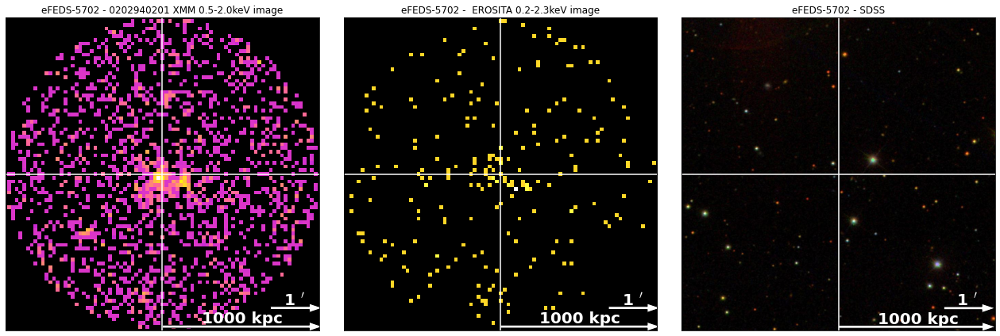

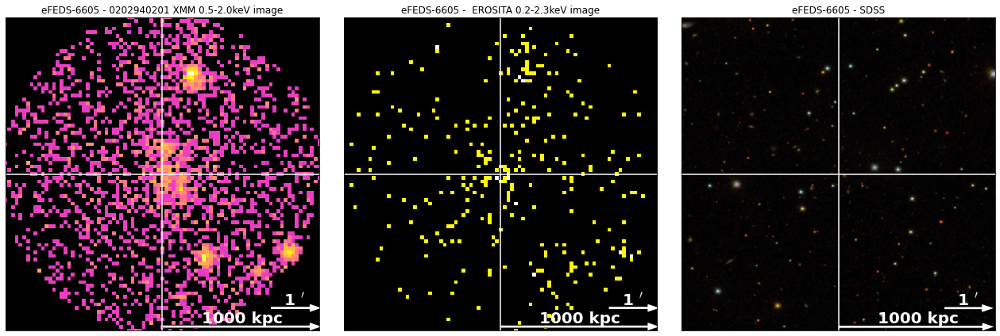

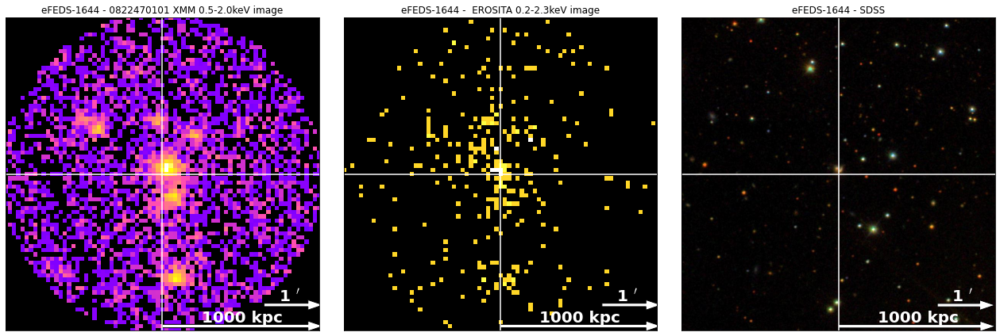

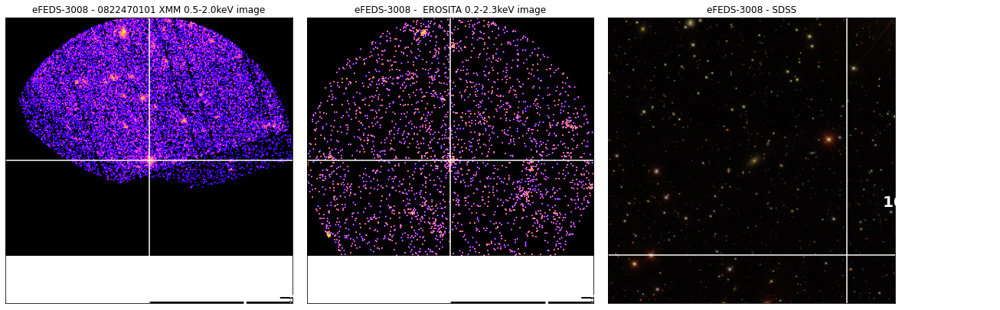

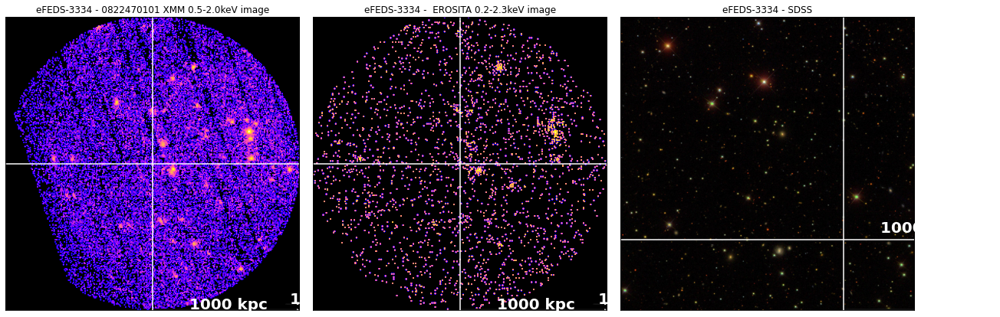

...

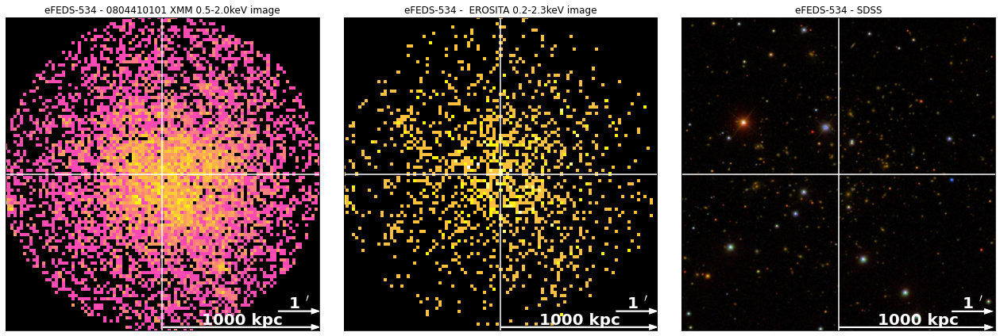

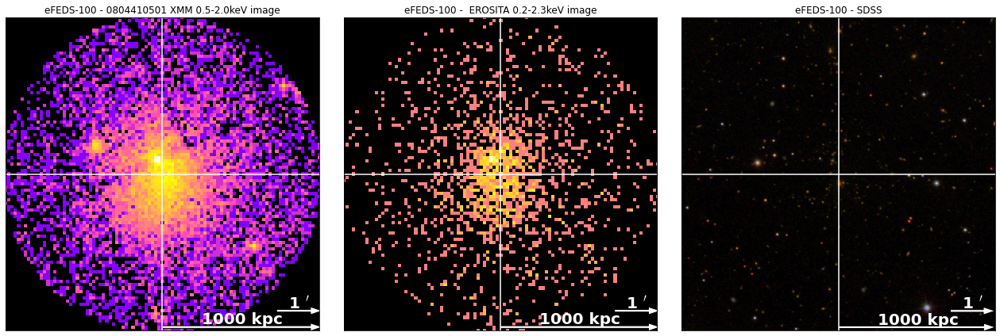

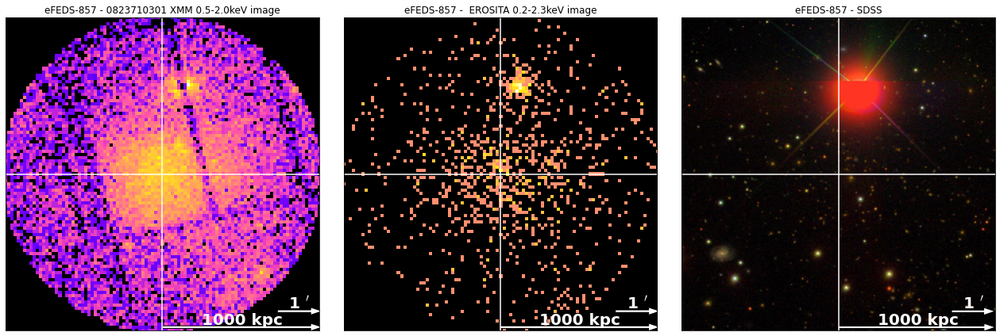

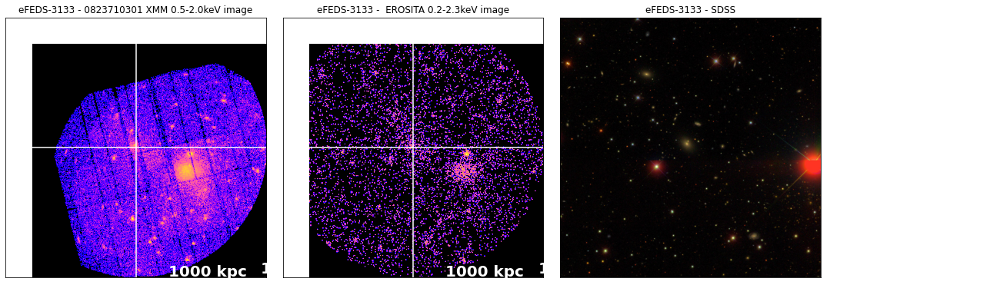

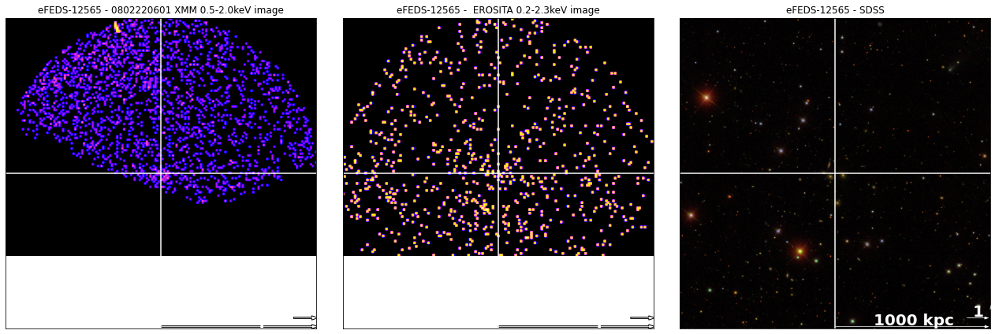

In [11]:
# Setting the aperture radius, this means we'll make images with a side length of twice this radius
ap_rad = Quantity(1000, 'kpc')
sdss_ap_rad = Quantity(1000, 'kpc')

# Iterate through every source in eFEDS-XMM
for src in srcs:
    side_by_side_by_side(src, ap_rad, sdss_ap_rad)

## Making slightly different images for the paper

There are some cases where the figure required for the paper needs to be slightly different to the general images we have generated already.

### Smaller than standard aperture for interacting active galaxies

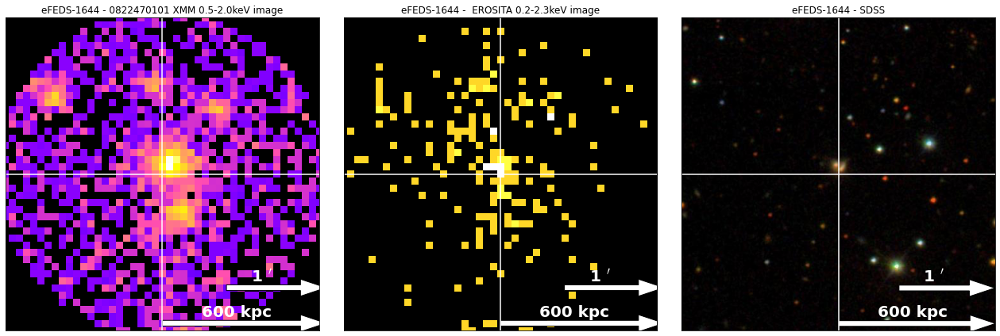

'output_figures/interacting_agn.png'

In [12]:
agn_path = side_by_side_by_side(srcs['eFEDS-1644'], Quantity(600, 'kpc'), Quantity(600, 'kpc'))
copyfile(agn_path, 'output_figures/'+'interacting_agn.png')

### Much smaller aperture for an example of an X-ray bright elliptical galaxy

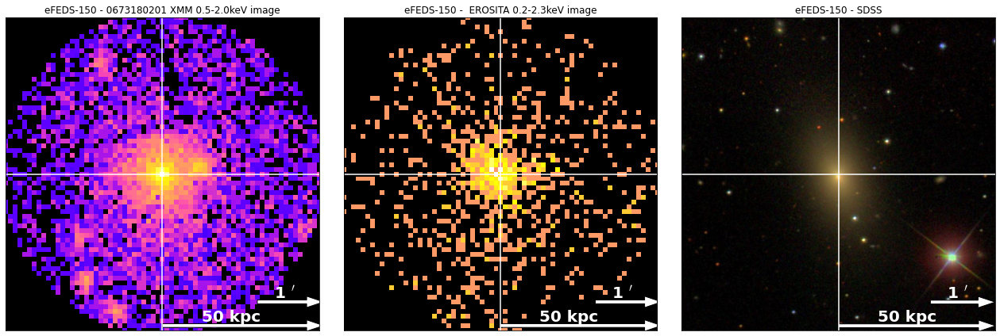

'output_figures/elliptical_xray.png'

In [13]:
ell_path = side_by_side_by_side(srcs['eFEDS-150'], Quantity(50, 'kpc'), Quantity(50, 'kpc'))
copyfile(ell_path, 'output_figures/'+'elliptical_xray.png')

### Smaller aperture than standard, with even smaller SDSS aperture

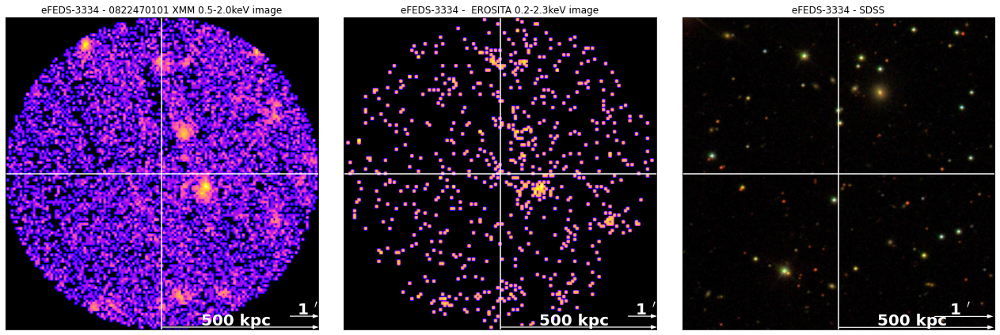

'output_figures/blank_lowz.png'

In [14]:
ell_path = side_by_side_by_side(srcs['eFEDS-3334'], Quantity(500, 'kpc'), Quantity(250, 'kpc'))
copyfile(ell_path, 'output_figures/'+'blank_lowz.png')

### Making an image for the split cluster candidate

Here we make an image specifically for the paper, where we highlight the two parts that the candidate has been broken into:

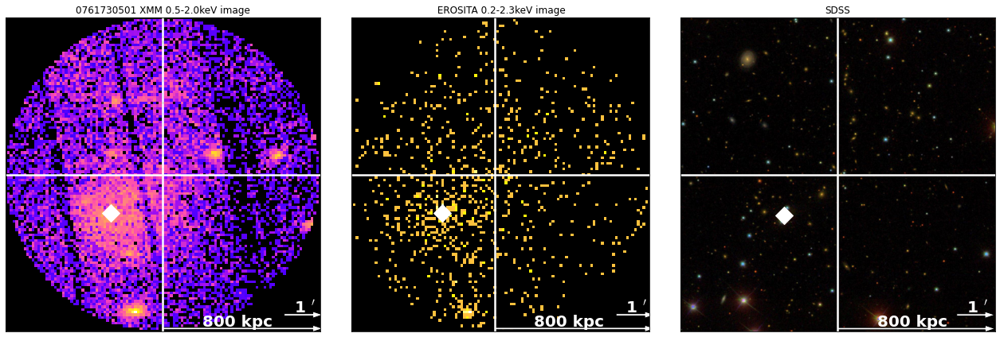

In [15]:
# Setting the aperture radius, this means we'll make images with a side length of twice this radius
ap_rad = Quantity(800, 'kpc')

part_one = srcs['eFEDS-8602'] 
part_two = srcs['eFEDS-1023']

# This function will grab the appropriate SDSS image if we haven't already got it, then return the
    #  path to the file
cur_sdss_path = fetch_sdss(part_one, part_one.ra_dec, ap_rad*2)
# The SDSS pixel positions of the two fragments
sdss_p1_pix_pos = conv_pos(part_one.ra_dec, part_one, part_one.ra_dec, ap_rad*2)
sdss_p2_pix_pos = conv_pos(part_two.ra_dec, part_one, part_one.ra_dec, ap_rad*2)

# Same deal as before, finding best XMM obs to compare to
ranks = part_one.snr_ranking(Quantity(300, 'kpc'))
best = ranks[0][-1]
cust_mask = part_one.get_custom_mask(ap_rad, obs_id=best[0], remove_interlopers=False)

# Setting up XGA image objects
xmm_im = Image(xmm_im_path.format(best[0]), best[0], 'XMM', '', '', '', Quantity(0.5, 'keV'), 
               Quantity(2.0, 'keV'))

efedim_path = efeds_im_path.format(best[0])
eros_im = Image(efedim_path, '', 'eROSITA', '', '', '', Quantity(0.2, 'keV'), 
                Quantity(2.3, 'keV'))

# Setting up the figure
fig, ax_arr = plt.subplots(ncols=3, figsize=(18, 6))
p1_pix_pos = xmm_im.coord_conv(part_one.ra_dec, 'pix')
p2_pix_pos = xmm_im.coord_conv(part_two.ra_dec, 'pix')

deg_ap = part_one.convert_radius(ap_rad, 'deg')
# Converting the aperture radius
xmm_pix = (deg_ap/pix_deg_scale(part_one.ra_dec, xmm_im.radec_wcs)).value.round().astype(int)

# Adding XMM, eROSITA, and SDSS images to the figure - along with an extra diamond marker to indicate
#  the other part of the candidate
plt.sca(ax_arr[0])
xmm_im_ax = xmm_im.get_view(ax_arr[0], p1_pix_pos, cust_mask, view_regions=True, zoom_in=True, 
                            ch_thickness=2.5)
ax_arr[0].tick_params(axis='both', direction='in', which='both', top=False, right=False, length=0)
ax_arr[0].plot(*p2_pix_pos.value, 'D', color='white', markersize=16)

# Define an arcminute to make the line after shorter
am = Quantity(1, 'arcmin')
# Find the number of pixels for an arcminute
xmm_arcmin = (am/pix_deg_scale(part_one.ra_dec, xmm_im.radec_wcs)).to('pix').value.round().astype(int)
xmm_cen = p1_pix_pos.value

# Add the aperture radius as an arrow, then label it with the input size of ap_rad
plt.arrow(xmm_cen[0], xmm_cen[1]-xmm_pix+1, xmm_pix+1, 0, fc='white', width=0.8, 
          length_includes_head=True)
plt.annotate("{v} {u}".format(v=int(ap_rad.value), u=ap_rad.unit.to_string()), 
             xy=(xmm_cen[0]+(xmm_pix/4), xmm_cen[1]-xmm_pix+2), color='white', fontsize=20, 
             xycoords='data', weight=700)

# For reference, we do the same arrow-adding business but with an arcminute
start_x = xmm_cen[0] + ((xmm_pix+1)-xmm_arcmin)
plt.arrow(start_x, xmm_cen[1]-xmm_pix+6, xmm_arcmin, 0, fc='white', width=0.8, 
          length_includes_head=True)
plt.annotate(r"1 $^\prime$", xy=(start_x+(xmm_arcmin/4), xmm_cen[1]-xmm_pix+7), color='white', 
             fontsize=20, xycoords='data', weight=700)

plt.sca(ax_arr[1])
eros_im_ax = eros_im.get_view(ax_arr[1], p1_pix_pos, cust_mask, view_regions=True, zoom_in=True, 
                              ch_thickness=2.5)
ax_arr[1].tick_params(axis='both', direction='in', which='both', top=False, right=False, length=0)
ax_arr[1].plot(*p2_pix_pos.value, 'D', color='white', markersize=16)

# Add the aperture radius as an arrow, then label it with the input size of ap_rad
plt.arrow(xmm_cen[0], xmm_cen[1]-xmm_pix+1, xmm_pix+1, 0, fc='white', width=0.8, 
          length_includes_head=True)
plt.annotate("{v} {u}".format(v=int(ap_rad.value), u=ap_rad.unit.to_string()), 
             xy=(xmm_cen[0]+(xmm_pix/4), xmm_cen[1]-xmm_pix+2), color='white', fontsize=20, 
             xycoords='data', weight=700)

# For reference, we do the same arrow-adding business but with an arcminute
start_x = xmm_cen[0] + ((xmm_pix+1)-xmm_arcmin)
plt.arrow(start_x, xmm_cen[1]-xmm_pix+6, xmm_arcmin, 0, fc='white', width=0.8, 
          length_includes_head=True)
plt.annotate(r"1 $^\prime$", xy=(start_x+(xmm_arcmin/4), xmm_cen[1]-xmm_pix+7), color='white', 
             fontsize=20, xycoords='data', weight=700)

# Add the SDSS image
ax = ax_arr[2]
plt.sca(ax)
cur_sdss_im = plt.imread(cur_sdss_path)

# The ratio between the number of pixels per side of the XMM/eROSITA images and the SDSS image
pix_ratio = cur_sdss_im.shape[0]/(xmm_pix*2)

sdss_pix_pos = np.array([sdss_p1_pix_pos[0].value, sdss_p1_pix_pos[1].value])

ax.tick_params(axis='both', direction='in', which='both', top=False, right=False, length=0)
ax.axhline(sdss_p1_pix_pos[1].value, color='white', linewidth=2.5)
ax.axvline(sdss_p1_pix_pos[0].value, color='white', linewidth=2.5)
ax_arr[2].plot(*sdss_p2_pix_pos, 'D', color='white', markersize=16)

ax.xaxis.set_ticklabels([])
ax.yaxis.set_ticklabels([])
ax.set_title("SDSS".format(n=src.name))
ax.imshow(cur_sdss_im, aspect="equal")#, origin='lower')
sdss_pix = int(round(cur_sdss_im.shape[0]/2, 0))
# Add the aperture radius as an arrow, then label it with the input size of ap_rad
plt.arrow(sdss_pix_pos[0], cur_sdss_im.shape[0]-(1*pix_ratio), sdss_pix+1, 0, fc='white', 
          width=0.8*pix_ratio, length_includes_head=True)
plt.annotate("{v} {u}".format(v=int(ap_rad.value), u=ap_rad.unit.to_string()), 
             xy=(sdss_pix_pos[0]+(sdss_pix/4), cur_sdss_im.shape[0]-(sdss_pix_pos[1]-sdss_pix+(2*pix_ratio))), 
             color='white', fontsize=20, xycoords='data', weight=700)

# For reference, we do the same arrow-adding business but with an arcminute
sdss_arcmin = (Quantity(1, 'arcmin')/sdss_pix_size).to('pix').round(0).astype(int).value
start_x = sdss_pix_pos[0] + ((sdss_pix)-sdss_arcmin)
plt.arrow(start_x, cur_sdss_im.shape[0]-(6*pix_ratio), sdss_arcmin, 0, fc='white', 
          width=0.8*pix_ratio,length_includes_head=True)
plt.annotate(r"1 $^\prime$", xy=(start_x+(sdss_arcmin/4), cur_sdss_im.shape[0]-(7*pix_ratio)), color='white', 
             fontsize=20, xycoords='data', weight=700)
# Try and minimise gaps between plots
plt.subplots_adjust(wspace=0, hspace=0)
plt.tight_layout()

# Save the final comparison image in the figures directory, as this goes into the paper
plt.savefig("output_figures/split_cluster.png")
# Show the image
plt.show()
plt.close('all')

## Better image for the spurious candidates near bright spiral galaxy

In this case we wanted to centre on very bright X-ray source that appears to be causing spurious extended source detections, rather than the candidate itself. As such the X-ray masks and SDSS image are generated centred on the coordinates of the bright source:

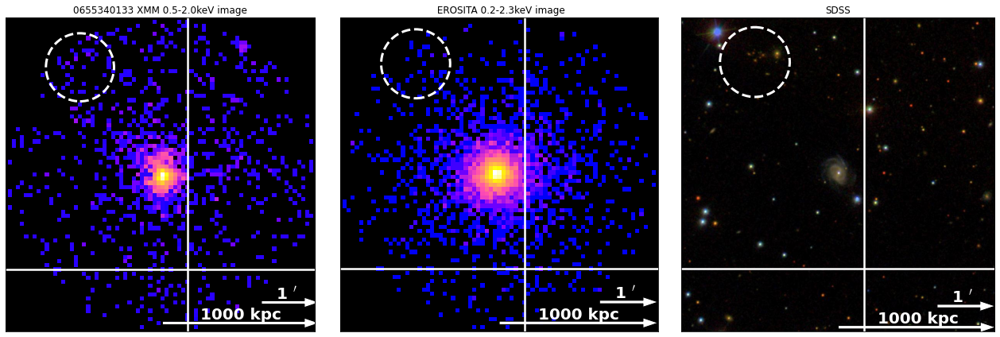

In [16]:
# Setting the aperture radius, this means we'll make images with a side length of twice this radius
ap_rad = Quantity(1000, 'kpc')

# The relevant source
src = srcs['eFEDS-8922']

deg_ap = src.convert_radius(ap_rad, 'deg')

# This is the position of the 
bright_src_pos = Quantity([134.07450039749338, -1.6358207558060298], 'deg')

# The sneaky cluster position
sneaky_cluster = Quantity([134.09836006559843,-1.6035882772505459], 'deg')
sc_src = srcs['eFEDS-16370']
sc_sdss_pix_pos = Quantity(conv_pos(sneaky_cluster, src, bright_src_pos, ap_rad*2))

# This function will grab the appropriate SDSS image if we haven't already got it, then return the
#  path to the file
cur_sdss_path = fetch_sdss(src, bright_src_pos, ap_rad*2)
# The SDSS pixel positions of the candidate relative to the big shiney source
sdss_pix_pos = Quantity(conv_pos(src.ra_dec, src, bright_src_pos, ap_rad*2))
sdss_cent_pix_pos = Quantity(conv_pos(src.ra_dec, src, src.ra_dec, ap_rad*2))

# Same deal as before, finding best XMM obs to compare to
ranks = src.snr_ranking(Quantity(300, 'kpc'))
best = ranks[0][-1]
cust_mask = src.get_custom_mask(ap_rad, obs_id=best[0], remove_interlopers=False, central_coord=bright_src_pos)

# Setting up XGA image objects
xmm_im = Image(xmm_im_path.format(best[0]), best[0], 'XMM', '', '', '', Quantity(0.5, 'keV'), 
               Quantity(2.0, 'keV'))

sneaky_cluster_pix = xmm_im.coord_conv(sneaky_cluster, 'pix')
bright_src_pos_pix = xmm_im.coord_conv(bright_src_pos, 'pix')

efedim_path = efeds_im_path.format(best[0])
eros_im = Image(efedim_path, '', 'eROSITA', '', '', '', Quantity(0.2, 'keV'), 
                Quantity(2.3, 'keV'))

# Setting up the figure
fig, ax_arr = plt.subplots(ncols=3, figsize=(18, 6))
pix_pos = xmm_im.coord_conv(src.ra_dec, 'pix')

# Adding XMM, eROSITA, and SDSS images to the figure
plt.sca(ax_arr[0])
xmm_im_ax = xmm_im.get_view(ax_arr[0], pix_pos, cust_mask, view_regions=True, zoom_in=True, 
                            ch_thickness=2.5)
ax_arr[0].tick_params(axis='both', direction='in', which='both', top=False, right=False, length=0)
rad = (sc_src.convert_radius(Quantity(200, 'kpc'), 'deg')/pix_deg_scale(sc_src.ra_dec, 
                                                                         xmm_im.radec_wcs)).to('pix')
xmm_circ = Circle(sneaky_cluster_pix.value, radius=rad.value, ec='white', fc='None', lw=3, ls='dashed')
ax_arr[0].add_patch(xmm_circ)

xmm_pix = (deg_ap/pix_deg_scale(part_one.ra_dec, xmm_im.radec_wcs)).value.round().astype(int)
# Define an arcminute to make the line after shorter
am = Quantity(1, 'arcmin')
# Find the number of pixels for an arcminute
xmm_arcmin = (am/pix_deg_scale(src.ra_dec, xmm_im.radec_wcs)).to('pix').value.round().astype(int)
xmm_cen = bright_src_pos_pix.value

# Add the aperture radius as an arrow, then label it with the input size of ap_rad
plt.arrow(xmm_cen[0], xmm_cen[1]-xmm_pix+1, xmm_pix+1, 0, fc='white', width=0.8, 
          length_includes_head=True)
plt.annotate("{v} {u}".format(v=int(ap_rad.value), u=ap_rad.unit.to_string()), 
             xy=(xmm_cen[0]+(xmm_pix/4), xmm_cen[1]-xmm_pix+2), color='white', fontsize=20, 
             xycoords='data', weight=700)

# For reference, we do the same arrow-adding business but with an arcminute
start_x = xmm_cen[0] + ((xmm_pix+1)-xmm_arcmin)
plt.arrow(start_x, xmm_cen[1]-xmm_pix+6, xmm_arcmin, 0, fc='white', width=0.8, 
          length_includes_head=True)
plt.annotate(r"1 $^\prime$", xy=(start_x+(xmm_arcmin/4), xmm_cen[1]-xmm_pix+7), color='white', 
             fontsize=20, xycoords='data', weight=700)

plt.sca(ax_arr[1])
eros_im_ax = eros_im.get_view(ax_arr[1], pix_pos, cust_mask, view_regions=True, zoom_in=True, 
                              ch_thickness=2.5)
ax_arr[1].tick_params(axis='both', direction='in', which='both', top=False, right=False, length=0)
eros_circ = Circle(sneaky_cluster_pix.value, radius=rad.value, ec='white', fc='None', lw=3, ls='dashed')
ax_arr[1].add_patch(eros_circ)

# Add the aperture radius as an arrow, then label it with the input size of ap_rad
plt.arrow(xmm_cen[0], xmm_cen[1]-xmm_pix+1, xmm_pix+1, 0, fc='white', width=0.8, 
          length_includes_head=True)
plt.annotate("{v} {u}".format(v=int(ap_rad.value), u=ap_rad.unit.to_string()), 
             xy=(xmm_cen[0]+(xmm_pix/4), xmm_cen[1]-xmm_pix+2), color='white', fontsize=20, 
             xycoords='data', weight=700)

# For reference, we do the same arrow-adding business but with an arcminute
start_x = xmm_cen[0] + ((xmm_pix+1)-xmm_arcmin)
plt.arrow(start_x, xmm_cen[1]-xmm_pix+6, xmm_arcmin, 0, fc='white', width=0.8, 
          length_includes_head=True)
plt.annotate(r"1 $^\prime$", xy=(start_x+(xmm_arcmin/4), xmm_cen[1]-xmm_pix+7), color='white', 
             fontsize=20, xycoords='data', weight=700)

# Add the SDSS image
ax = ax_arr[2]
plt.sca(ax)
cur_sdss_im = plt.imread(cur_sdss_path)
ax.tick_params(axis='both', direction='in', which='both', top=False, right=False, length=0)
ax.axhline(sdss_pix_pos[1].value, color='white', linewidth=2.5)
ax.axvline(sdss_pix_pos[0].value, color='white', linewidth=2.5)

ax.xaxis.set_ticklabels([])
ax.yaxis.set_ticklabels([])
ax.set_title("SDSS".format(n=src.name))
ax.imshow(cur_sdss_im, aspect="equal")

rad = (sc_src.convert_radius(Quantity(200, 'kpc'), 'deg')/sdss_pix_size).to('pix')
sdss_circ = Circle(sc_sdss_pix_pos.value, radius=rad.value, ec='white', fc='None', lw=3, ls='dashed')
ax_arr[2].add_patch(sdss_circ)

pix_ratio = cur_sdss_im.shape[0]/(xmm_pix*2)
sdss_pix_pos = sdss_pix_pos.value
sdss_pix = int(round(cur_sdss_im.shape[0]/2, 0))
# Add the aperture radius as an arrow, then label it with the input size of ap_rad
plt.arrow(sdss_cent_pix_pos[0].value, cur_sdss_im.shape[0]-(1*pix_ratio), sdss_pix+1, 0, fc='white', 
          width=0.8*pix_ratio, length_includes_head=True)

plt.annotate("{v} {u}".format(v=int(ap_rad.value), u=ap_rad.unit.to_string()), 
             xy=(sdss_cent_pix_pos[0].value+(sdss_pix/4), cur_sdss_im.shape[0]-(sdss_cent_pix_pos[1].value-sdss_pix+(2*pix_ratio))), 
             color='white', fontsize=20, xycoords='data', weight=700)

# For reference, we do the same arrow-adding business but with an arcminute
sdss_arcmin = (Quantity(1, 'arcmin')/sdss_pix_size).to('pix').round(0).astype(int).value
start_x = sdss_cent_pix_pos[0].value + ((sdss_pix)-sdss_arcmin)
plt.arrow(start_x, cur_sdss_im.shape[0]-(6*pix_ratio), sdss_arcmin, 0, fc='white', 
          width=0.8*pix_ratio,length_includes_head=True)
plt.annotate(r"1 $^\prime$", xy=(start_x+(sdss_arcmin/4), cur_sdss_im.shape[0]-(7*pix_ratio)), color='white', 
             fontsize=20, xycoords='data', weight=700)

# Try and minimise gaps between plots
plt.subplots_adjust(wspace=0, hspace=0)
plt.tight_layout()

# Save the final comparison image in the figures directory, as this goes into the paper
plt.savefig("output_figures/outskirt_cands.png")
# Show the image
plt.show()
plt.close('all')